Data preparation:
* Load data: Load data from various sources such as CSV files, databases or APIs.
* Clean data: Remove missing values, duplicates and inconsistent data.
* Transform data: Perform data manipulations such as converting data types, creating new variables and aggregating data.
* Explore data: Examine the distribution of data, Identify outliers and correlations between variables.

Load data: Load data from various sources such as CSV files, databases or APIs.


In [2]:
# import the necessary libraries you need for your analysis
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
# Floats (decimal numbers) should be displayed rounded with 2 decimal places
pd.options.display.float_format = "{:,.2f}".format
# Set style for plots
plt.style.use('fivethirtyeight') 

In [4]:
# read in csv file and display first 5 rows of datset
df = pd.read_csv("/Users/aileenpfleiderer/Desktop/GitHub_datasets_Aileen/repositories.csv")
df.head()

,Name,Description,URL,Created At,Updated At,Homepage,Size,Stars,Forks,Issues,...,Has Issues,Has Projects,Has Downloads,Has Wiki,Has Pages,Has Discussions,Is Fork,Is Archived,Is Template,Default Branch
0,freeCodeCamp,freeCodeCamp.org's open-source codebase and cu...,https://github.com/freeCodeCamp/freeCodeCamp,2014-12-24T17:49:19Z,2023-09-21T11:32:33Z,http://contribute.freecodecamp.org/,387451,374074,33599,248,...,True,True,True,False,True,False,False,False,False,main
1,free-programming-books,:books: Freely available programming books,https://github.com/EbookFoundation/free-progra...,2013-10-11T06:50:37Z,2023-09-21T11:09:25Z,https://ebookfoundation.github.io/free-program...,17087,298393,57194,46,...,True,False,True,False,True,False,False,False,False,main
2,awesome,😎 Awesome lists about all kinds of interesting...,https://github.com/sindresorhus/awesome,2014-07-11T13:42:37Z,2023-09-21T11:18:22Z,NaN,1441,269997,26485,61,...,True,False,True,False,True,False,False,False,False,main
3,996.ICU,Repo for counting stars and contributing. Pres...,https://github.com/996icu/996.ICU,2019-03-26T07:31:14Z,2023-09-21T08:09:01Z,https://996.icu,187799,267901,21497,16712,...,False,False,True,False,False,False,False,True,False,master
4,coding-interview-university,A complete computer science study plan to beco...,https://github.com/jwasham/coding-interview-un...,2016-06-06T02:34:12Z,2023-09-21T10:54:48Z,NaN,20998,265161,69434,56,...,True,False,True,False,False,False,False,False,False,main


In [5]:
# check which columns are included in our dataframe
df.columns

Index(['Name', 'Description', 'URL', 'Created At', 'Updated At', 'Homepage',
       'Size', 'Stars', 'Forks', 'Issues', 'Watchers', 'Language', 'License',
       'Topics', 'Has Issues', 'Has Projects', 'Has Downloads', 'Has Wiki',
       'Has Pages', 'Has Discussions', 'Is Fork', 'Is Archived', 'Is Template',
       'Default Branch'],
      dtype='object')

In [6]:
# Let's have a look at the shape of our dataset, meaning how long and wide it is.
df.shape

(215029, 24)

Clean data: Remove missing values, duplicates and inconsistent data.

In [7]:
# We now want to check out our data-types as well as get a feeling for possible missing values
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 215029 entries, 0 to 215028
Data columns (total 24 columns):
 #   Column           Non-Null Count   Dtype 
---  ------           --------------   ----- 
 0   Name             215027 non-null  object
 1   Description      206997 non-null  object
 2   URL              215029 non-null  object
 3   Created At       215029 non-null  object
 4   Updated At       215029 non-null  object
 5   Homepage         78390 non-null   object
 6   Size             215029 non-null  int64 
 7   Stars            215029 non-null  int64 
 8   Forks            215029 non-null  int64 
 9   Issues           215029 non-null  int64 
 10  Watchers         215029 non-null  int64 
 11  Language         198953 non-null  object
 12  License          161990 non-null  object
 13  Topics           215029 non-null  object
 14  Has Issues       215029 non-null  bool  
 15  Has Projects     215029 non-null  bool  
 16  Has Downloads    215029 non-null  bool  
 17  Has Wiki  

Clean data: Remove missing values, duplicates and inconsistent data.

we see a lot of object and bool data types. this needs to be checked in detail for possible convertions
Name is kind of string>change
Description same
URL same


In [ ]:
# it needs to be converted into the right dtype
# missings maybe need to be deleted/dropped

In [8]:
topics_value_counts = df['Topics'].value_counts()
print("The number of different values in the 'Topics' column is:")
print(topics_value_counts)

The number of different values in the 'Topics' column is:
Topics
[]                                                                                                                                                                                                                                    101072
['hacktoberfest']                                                                                                                                                                                                                        454
['python']                                                                                                                                                                                                                                52
['android']                                                                                                                                                                                                                     

In [11]:
topic_name_counts = df.groupby(['Topics', 'Name']).size().reset_index(name='Count')
print(topic_name_counts)


                                                   Topics        Name  Count
0       ['0-legacy', 'deno', 'esm', 'no-bundle', 'reac...       ultra      1
1       ['0-rtt', 'golang', 'hijacking', 'http-proxy',...  quic-proxy      1
2       ['010editor', 'binary-data', 'dataparsing', 'i...         pfp      1
3       ['010editor', 'lua', 'luadec', 'luajit', 'reve...      lua_re      1
4       ['011y', 'apm', 'clickhouse', 'grafana', 'infl...        qryn      1
...                                                   ...         ...    ...
209640                                                 []      zytrax      1
209641                                                 []          zz      1
209642                                                 []       zzkia      1
209643                                                 []        zzuf      1
209644                                                 []       zzzzz      1

[209645 rows x 3 columns]


In [ ]:
# NLP stuff

In [14]:
#English components in Topics
import spacy

# Load the pre-trained model for English
nlp = spacy.load("en_core_web_sm")

# Apply NER to each username in the DataFrame
def extract_named_entities(Topics):
    doc = nlp(Topics)
    named_entities = [(ent.text, ent.label_) for ent in doc.ents]
    return named_entities

# Apply the function to the entire DataFrame
df['named_entities'] = df['Topics'].apply(extract_named_entities)


In [15]:
#German components in Topics
import spacy

# Load the pre-trained model for German
nlp_de = spacy.load("de_core_news_sm")

# Function to extract named entities from a German text
def extract_named_entities_de(Topics):
    doc = nlp_de(Topics)
    named_entities = [(ent.text, ent.label_) for ent in doc.ents]
    return named_entities

# Apply the function to the entire DataFrame
df['named_entities_german'] = df['Topics'].apply(extract_named_entities_de)

In [16]:
df.head()

,Name,Description,URL,Created At,Updated At,Homepage,Size,Stars,Forks,Issues,...,Has Downloads,Has Wiki,Has Pages,Has Discussions,Is Fork,Is Archived,Is Template,Default Branch,named_entities,named_entities_german
0,freeCodeCamp,freeCodeCamp.org's open-source codebase and cu...,https://github.com/freeCodeCamp/freeCodeCamp,2014-12-24T17:49:19Z,2023-09-21T11:32:33Z,http://contribute.freecodecamp.org/,387451,374074,33599,248,...,True,False,True,False,False,False,False,main,[],"[(['careers, ORG), (freecodecamp, PER), (javas..."
1,free-programming-books,:books: Freely available programming books,https://github.com/EbookFoundation/free-progra...,2013-10-11T06:50:37Z,2023-09-21T11:09:25Z,https://ebookfoundation.github.io/free-program...,17087,298393,57194,46,...,True,False,True,False,False,False,False,main,[],[]
2,awesome,😎 Awesome lists about all kinds of interesting...,https://github.com/sindresorhus/awesome,2014-07-11T13:42:37Z,2023-09-21T11:18:22Z,NaN,1441,269997,26485,61,...,True,False,True,False,False,False,False,main,[],"[(resources, PER)]"
3,996.ICU,Repo for counting stars and contributing. Pres...,https://github.com/996icu/996.ICU,2019-03-26T07:31:14Z,2023-09-21T08:09:01Z,https://996.icu,187799,267901,21497,16712,...,True,False,False,False,False,True,False,master,[],[]
4,coding-interview-university,A complete computer science study plan to beco...,https://github.com/jwasham/coding-interview-un...,2016-06-06T02:34:12Z,2023-09-21T10:54:48Z,NaN,20998,265161,69434,56,...,True,False,False,False,False,False,False,main,[],"[(data-structures, PER)]"


In [17]:
# here there are no entries in the new column named entity?

# Iterate over the DataFrame and check for non-empty named entity values
for index, row in df.iterrows():
    named_entities = row['named_entities']
    if named_entities:
        print(f"At index {index}, named entities found: {named_entities}")
    else:
        print(f"At index {index}, no named entities found.")

# it seems that the english version did not reveal any components of topics? 

At index 0, no named entities found.
At index 1, no named entities found.
At index 2, no named entities found.
At index 3, no named entities found.
At index 4, no named entities found.
At index 5, no named entities found.
At index 6, no named entities found.
At index 7, no named entities found.
At index 8, no named entities found.
At index 9, no named entities found.
At index 10, no named entities found.
At index 11, no named entities found.
At index 12, no named entities found.
At index 13, no named entities found.
At index 14, no named entities found.
At index 15, no named entities found.
At index 16, no named entities found.
At index 17, no named entities found.
At index 18, no named entities found.
At index 19, no named entities found.
At index 20, no named entities found.
At index 21, no named entities found.
At index 22, no named entities found.
At index 23, no named entities found.
At index 24, no named entities found.
At index 25, named entities found: [('gpt-4', 'PERSON')]
At 

In [18]:
# here there are no entries in the new column named_entities_german?

# Iterate over the DataFrame and check for non-empty named entity german values
for index, row in df.iterrows():
    named_entities_german = row['named_entities_german']
    if named_entities_german:
        print(f"At index {index}, named entities german found: {named_entities_german}")
    else:
        print(f"At index {index}, no named entities german found.")

# the German version reveal components of topics

At index 0, named entities german found: [("['careers", 'ORG'), ('freecodecamp', 'PER'), ('javascript', 'MISC'), ('math', 'PER')]
At index 1, no named entities german found.
At index 2, named entities german found: [('resources', 'PER')]
At index 3, no named entities german found.
At index 4, named entities german found: [('data-structures', 'PER')]
At index 5, named entities german found: [('resources', 'PER')]
At index 6, named entities german found: [("['angular-roadmap", 'ORG'), ('blockchain-roadmap', 'PER')]
At index 7, named entities german found: [('python', 'MISC')]
At index 8, no named entities german found.
At index 9, named entities german found: [('javascript', 'MISC')]
At index 10, named entities german found: [('javascript', 'MISC')]
At index 11, named entities german found: [('collections', 'PER'), ('python', 'MISC')]
At index 12, named entities german found: [("['deep-learning", 'ORG'), ('python', 'MISC')]
At index 13, named entities german found: [('data-structures', '

In [21]:
# English ones? 
# how many named entities could be found? in total? 

# Initialize a variable to store the total count of named entities
total_named_entities = 0

# Iterate over the named entities column and count non-empty values
for named_entities in df['named_entities']:
    if named_entities:
        total_named_entities += len(named_entities)

# Print the total count of named entities
print("Total number of found named entities:", total_named_entities)

Total number of found named entities: 13194


In [23]:
# German ones? 
# how many named entities could be found? in total? 

# Initialize a variable to store the total count of named entities
total_named_entities_german = 0

# Iterate over the named entities column and count non-empty values
for named_entities_german in df['named_entities_german']:
    if named_entities_german:
        total_named_entities_german += len(named_entities_german)

# Print the total count of named entities
print("Total number of found named entities:", total_named_entities_german)


Total number of found named entities: 102752


In [ ]:
# 102752 German components in topics
# 13194 English components in topics

In [24]:
# which kind of components - English

# check how many unique types SpaCy here in our df has found? 

# Initialize a dictionary to count the occurrences of each named entity type
entity_types_count = {}

# Iterate over the named entities found in each row and count the occurrences of each type
for entities in df['named_entities']:
    for entity in entities:
        entity_type = entity[1]  # Extract the entity type
        if entity_type in entity_types_count:
            entity_types_count[entity_type] += 1
        else:
            entity_types_count[entity_type] = 1

# Display the count of occurrences for each named entity type
for entity_type, count in entity_types_count.items():
    print(f"{entity_type}: {count}")

PERSON: 3969
PRODUCT: 79
CARDINAL: 1839
ORDINAL: 302
ORG: 2681
NORP: 1135
GPE: 1107
DATE: 1455
WORK_OF_ART: 354
LOC: 54
LANGUAGE: 59
MONEY: 92
LAW: 8
TIME: 12
QUANTITY: 36
FAC: 5
EVENT: 6
PERCENT: 1


In [69]:
df.columns

Index(['Name', 'Description', 'URL', 'Created At', 'Updated At', 'Homepage',
       'Size', 'Stars', 'Forks', 'Issues', 'Watchers', 'Language', 'License',
       'Topics', 'Has Issues', 'Has Projects', 'Has Downloads', 'Has Wiki',
       'Has Pages', 'Has Discussions', 'Is Fork', 'Is Archived', 'Is Template',
       'Default Branch', 'named_entities', 'named_entities_german', 'Success'],
      dtype='object')

In [71]:
df.tail(10)

,Name,Description,URL,Created At,Updated At,Homepage,Size,Stars,Forks,Issues,...,Has Wiki,Has Pages,Has Discussions,Is Fork,Is Archived,Is Template,Default Branch,named_entities,named_entities_german,Success
215019,SwiftChatApp,Realtime firebase chat app written in Swift 5,https://github.com/AfrazCodes/SwiftChatApp,2020-06-06T19:26:03Z,2023-09-25T08:34:48Z,NaN,47773,167,62,5,...,True,False,False,False,False,False,master,[],[],229
215020,t,A Runtime Typechecker for Roblox,https://github.com/osyrisrblx/t,2018-06-26T00:07:56Z,2023-09-23T16:45:36Z,NaN,201,167,37,3,...,False,False,False,False,False,False,master,[],[],204
215021,SIT.Aki-Server-Mod,An Escape From Tarkov SPT Aki server mod to en...,https://github.com/paulov-t/SIT.Aki-Server-Mod,2023-01-21T13:36:31Z,2023-09-25T16:39:39Z,https://github.com/paulov-t/SIT.Core,23960,167,41,0,...,False,False,False,False,False,False,master,[],"[(tarkov, PER)]",208
215022,TMRB,TikTok Mass Report Bot,https://github.com/Lorenzik/TMRB,2022-09-29T18:33:07Z,2023-09-25T19:09:09Z,NaN,3,167,64,15,...,True,False,False,False,False,False,main,[],"[(tiktok, PER)]",231
215023,TouchyBP,Touchy™ Boilerplate,https://github.com/doat/TouchyBP,2011-09-09T19:13:24Z,2022-10-26T08:15:51Z,http://labs.doat.com,1693,167,18,0,...,True,False,False,False,False,False,master,[],[],185
215024,puppet-virt,Puppet Module for Virtualization Management,https://github.com/carlasouza/puppet-virt,2010-06-06T21:42:34Z,2023-01-27T12:13:50Z,http://puppetlabs.com,573,167,73,11,...,True,False,False,False,False,False,master,[],[],240
215025,BounceProgressBar,Android BounceProgressBar Widget,https://github.com/zhengxiaopeng/BounceProgres...,2014-11-17T12:19:13Z,2022-11-29T16:50:03Z,NaN,2219,167,36,2,...,True,False,False,False,False,False,master,[],[],203
215026,egghead-angularjs-from-scratch-getting-started,NaN,https://github.com/eggheadio/egghead-angularjs...,2014-08-04T12:56:15Z,2022-03-13T19:20:21Z,NaN,81,167,221,2,...,True,False,False,False,False,False,master,[],[],388
215027,Pcode,Python 3 IDE,https://github.com/fortharris/Pcode,2013-07-29T08:55:29Z,2022-12-15T13:11:25Z,NaN,15617,167,24,4,...,True,False,False,False,False,False,master,[],[],191
215028,react-hooks,Fire off actions in stateless components.,https://github.com/tj/react-hooks,2016-09-19T23:26:58Z,2023-09-01T07:10:16Z,NaN,3,167,9,3,...,True,False,False,False,False,False,master,[],[],176


In [77]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 215029 entries, 0 to 215028
Data columns (total 27 columns):
 #   Column                 Non-Null Count   Dtype 
---  ------                 --------------   ----- 
 0   Name                   215027 non-null  object
 1   Description            206997 non-null  object
 2   URL                    215029 non-null  object
 3   Created At             215029 non-null  object
 4   Updated At             215029 non-null  object
 5   Homepage               78390 non-null   object
 6   Size                   215029 non-null  int64 
 7   Stars                  215029 non-null  int64 
 8   Forks                  215029 non-null  int64 
 9   Issues                 215029 non-null  int64 
 10  Watchers               215029 non-null  int64 
 11  Language               198953 non-null  object
 12  License                161990 non-null  object
 13  Topics                 215029 non-null  object
 14  Has Issues             215029 non-null  bool  
 15  

In [78]:
df["named_entities"].sum()

[('gpt-4', 'PERSON'),
 ('es2016', 'PERSON'),
 ('tc39', 'PRODUCT'),
 ('one', 'CARDINAL'),
 ('zero', 'CARDINAL'),
 ('first', 'ORDINAL'),
 ('pwa', 'ORG'),
 ('webpack4', 'PERSON'),
 ('koa2', 'ORG'),
 ('chinese', 'NORP'),
 ('nasa', 'ORG'),
 ('pwa', 'ORG'),
 ("activerecord'", 'ORG'),
 ('pwa', 'ORG'),
 ('chinese', 'NORP'),
 ('gpt-4', 'PERSON'),
 ('socks5', 'PERSON'),
 ('gpt-4', 'PERSON'),
 ('gpt3', 'ORG'),
 ('chinese', 'NORP'),
 ('chinese', 'NORP'),
 ('letsencrypt', 'GPE'),
 ('meteor', 'ORG'),
 ('zero', 'CARDINAL'),
 ('gpt-4', 'PERSON'),
 ("julia-language'", 'ORG'),
 ('socks5', 'PERSON'),
 ('sqlite3', 'PERSON'),
 ('windows-10', 'DATE'),
 ('windows-11', 'DATE'),
 ("100-days-of-code-log'", 'DATE'),
 ('100daysofcode', 'DATE'),
 ('gpt-4', 'PERSON'),
 ('first', 'ORDINAL'),
 ('meteor', 'ORG'),
 ("json-diff'", 'ORG'),
 ('rfc-6902', 'DATE'),
 ('rfc-7049', 'DATE'),
 ('rfc-7159', 'DATE'),
 ('kmeans', 'NORP'),
 ('monaco', 'GPE'),
 ('bootstrap5', 'PERSON'),
 ('java8', 'PERSON'),
 ("wai-aria'", 'PERSON'),

In [25]:
# check how many unique types SpaCy here in our df has found? - German 

# Initialize a dictionary to count the occurrences of each named entity type german
entity_types_count = {}

# Iterate over the named entities german found in each row and count the occurrences of each type
for entities in df['named_entities_german']:
    for entity in entities:
        entity_type = entity[1]  # Extract the entity type
        if entity_type in entity_types_count:
            entity_types_count[entity_type] += 1
        else:
            entity_types_count[entity_type] = 1

# Display the count of occurrences for each named entity type german
for entity_type, count in entity_types_count.items():
    print(f"{entity_type}: {count}")

ORG: 17023
PER: 45031
MISC: 38417
LOC: 2281


In [ ]:
# seems no entries

In [ ]:
# check and analyze the content of each automatically extracted components 

In [ ]:
#Top 15 Hard Skills from table skills_counts_jobs_20 ranking (from 2020)
 # manually reviewed for integrating here (potentially importance checked)
#1 Analytics
#2 SQL (Programming Language)
#3 Tooling
#4 Maintainability
#5 Disabilities
#6 Data Quality
#7 Levelling
#8 Equalization
#9 Statistics
#10 Industrialization
#11 Dashboard
#12 Tableau (Business Intelligence Software)
#13 Activism
#14 Python (Programming Language)
#15 Component Object Model (COM)


In [ ]:
#Top 15 Soft Skills from table skills_counts_jobs_20 ranking (from 2020)
 # manually reviewed for integrating here (potentially importance checked)
#1 Management
#2 Communications
#3 Positivity
#4 Research
#5 
#6  
#7 
#8 
#9
#10
#11
#12
#13
#14
#15

In [44]:
# first try with four soft skills form list
# Define the keywords to search for
keywords = ["Management", "Communications", "Positivity", "Research","Operations","Collaboration","Presentations","Plannung","Integration","Decisiveness"]

# Function to extract job-related named entities in German
def extract_job_related_named_entities_german(df):
    # List to store job-related named entities
    job_related_named_entities_german = []
    # Iterate through each row in the 'named_entities_german' column
    for named_entities_german_list in df['named_entities_german']:
        for named_entities_german_tuple in named_entities_german_list:
            # Convert the tuple to a string
            named_entities_german = named_entities_german_tuple[0]
            # Check if any of the keywords are present in the named entities
            if any(keyword.lower() in named_entities_german.lower() for keyword in keywords):
                job_related_named_entities_german.append(named_entities_german)
    return job_related_named_entities_german

# Call the function with the DataFrame df
job_related_named_entities_german = extract_job_related_named_entities_german(df)

# Display the extracted named entities
print(job_related_named_entities_german)




['security-researchers', "['presentations", 'machine-learning-operations', 'ml-operations', 'database-management', 'presentations', 'rbac-management', 'boolean-operations', 'presentations', 'machine-learning-operations', 'machine-learning-operations', 'database-management', 'database-management', 'presentations', 'inventory-management-system', 'database-management', "['cancer-imaging-research'", "['cloud-management", 'sentence-representations', 'flutter-state-management', 'presentations', 'flutter-state-management', 'database-management', "['communications", 'presentations', 'react-state-management', "['container-management", 'database-management', "['container-management", 'database-management', "['cloud-native', 'cluster-management", 'conference-presentations', 'neural-scene-representations', 'rbac-management', 'database-management', "['distributed-representations", 'presentations', "['cff-wg-service-management", 'operations-research', "['communications", "['effortless-integrations",

In [45]:
# Function to extract job-related named entities in German with their corresponding names
def extract_job_related_named_entities_german_with_names(df):
    # List to store tuples of job-related named entities and their corresponding names
    job_related_named_entities_german_with_names = []
    # Iterate through each row in the 'named_entities_german' column
    for named_entities_german_list in df['named_entities_german']:
        for named_entities_german_tuple in named_entities_german_list:
            # Extract the named entity and its corresponding name from the tuple
            named_entity = named_entities_german_tuple[0]
            named_entity_name = named_entities_german_tuple[1]
            # Check if any of the keywords are present in the named entities
            if any(keyword.lower() in named_entity.lower() for keyword in keywords):
                job_related_named_entities_german_with_names.append((named_entity, named_entity_name))
    return job_related_named_entities_german_with_names

# Call the function with the DataFrame df
job_related_named_entities_german_with_names = extract_job_related_named_entities_german_with_names(df)

# Display the extracted named entities with their corresponding names
for named_entity, named_entity_name in job_related_named_entities_german_with_names:
    print("Named Entity:", named_entity)
    print("Named Entity Name:", named_entity_name)
    print()


Named Entity: security-researchers
Named Entity Name: PER

Named Entity: ['presentations
Named Entity Name: ORG

Named Entity: machine-learning-operations
Named Entity Name: PER

Named Entity: ml-operations
Named Entity Name: PER

Named Entity: database-management
Named Entity Name: PER

Named Entity: presentations
Named Entity Name: PER

Named Entity: rbac-management
Named Entity Name: MISC

Named Entity: boolean-operations
Named Entity Name: PER

Named Entity: presentations
Named Entity Name: PER

Named Entity: machine-learning-operations
Named Entity Name: PER

Named Entity: machine-learning-operations
Named Entity Name: PER

Named Entity: database-management
Named Entity Name: PER

Named Entity: database-management
Named Entity Name: PER

Named Entity: presentations
Named Entity Name: PER

Named Entity: inventory-management-system
Named Entity Name: MISC

Named Entity: database-management
Named Entity Name: PER

Named Entity: ['cancer-imaging-research'
Named Entity Name: ORG

Named

In [46]:
from collections import Counter

# Extracted job-related named entities
job_related_named_entities = [named_entity for named_entity, _ in job_related_named_entities_german_with_names]

# Count the occurrences of each keyword
keyword_counts = Counter(keyword.lower() for keyword in keywords if keyword.lower() in ' '.join(job_related_named_entities).lower())

# Display the counts of each keyword
for keyword, count in keyword_counts.items():
    print(f"Keyword: {keyword}, Count: {count}")



Keyword: management, Count: 1
Keyword: communications, Count: 1
Keyword: research, Count: 1
Keyword: operations, Count: 1
Keyword: collaboration, Count: 1
Keyword: presentations, Count: 1
Keyword: integration, Count: 1


In [48]:
#try again. just got counts of single keywords and not if they are component .. new count!
from collections import Counter

# Keywords to search for
# don't forget to enter from above!
keywords = ["Management", "Communications", "Positivity", "Research","Operations","Collaboration","Presentations","Plannung","Integration","Decisiveness"]

# Initialize a counter
keyword_counter = Counter()

# Iterate through each named entity and count occurrences of keywords
for named_entity in job_related_named_entities_german:
    for keyword in keywords:
        if keyword.lower() in named_entity.lower():
            keyword_counter[keyword] += 1

# Print the counts for each keyword
for keyword, count in keyword_counter.items():
    print(f"Keyword: {keyword.capitalize()}, Count: {count}")


Keyword: Research, Count: 16
Keyword: Presentations, Count: 36
Keyword: Operations, Count: 16
Keyword: Management, Count: 82
Keyword: Communications, Count: 7
Keyword: Integration, Count: 10
Keyword: Collaboration, Count: 1


In [ ]:
# not only finding the exact keyword, but more finding the "around" words

In [49]:
# Hard Skill Analysis from list
# Define the keywords to search for
keywords = ["Analytics","SQL","Tooling","Maintainability","Disabilities","Data Quality","Levelling","Equalization","Statistics","Industrialization","Dashboard","Tableau","Programming Language","Business Intelligence","Python"]

# Function to extract job-related named entities in German
def extract_job_related_named_entities_german(df):
    # List to store job-related named entities
    job_related_named_entities_german = []
    # Iterate through each row in the 'named_entities_german' column
    for named_entities_german_list in df['named_entities_german']:
        for named_entities_german_tuple in named_entities_german_list:
            # Convert the tuple to a string
            named_entities_german = named_entities_german_tuple[0]
            # Check if any of the keywords are present in the named entities
            if any(keyword.lower() in named_entities_german.lower() for keyword in keywords):
                job_related_named_entities_german.append(named_entities_german)
    return job_related_named_entities_german

# Call the function with the DataFrame df
job_related_named_entities_german = extract_job_related_named_entities_german(df)

# Display the extracted named entities
print(job_related_named_entities_german)


['python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', "['analytics'", 'python', 'python', 'python', 'scikit-learn-python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'sqlserver', 'python', 'python', 'python', 'python', 'python', 'python', 'python', "['analytics'", 'sqlserver', 'python', 'python', 'python', 'python', 'sqlserver', 'python', "['analytics'", 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'python', "['analytics'", 'python', 'python', 'python', 'python', 'python', 'python', 'python', 'py

In [50]:
# Function to extract job-related named entities in German with their corresponding names
def extract_job_related_named_entities_german_with_names(df):
    # List to store tuples of job-related named entities and their corresponding names
    job_related_named_entities_german_with_names = []
    # Iterate through each row in the 'named_entities_german' column
    for named_entities_german_list in df['named_entities_german']:
        for named_entities_german_tuple in named_entities_german_list:
            # Extract the named entity and its corresponding name from the tuple
            named_entity = named_entities_german_tuple[0]
            named_entity_name = named_entities_german_tuple[1]
            # Check if any of the keywords are present in the named entities
            if any(keyword.lower() in named_entity.lower() for keyword in keywords):
                job_related_named_entities_german_with_names.append((named_entity, named_entity_name))
    return job_related_named_entities_german_with_names

# Call the function with the DataFrame df
job_related_named_entities_german_with_names = extract_job_related_named_entities_german_with_names(df)

# Display the extracted named entities with their corresponding names
for named_entity, named_entity_name in job_related_named_entities_german_with_names:
    print("Named Entity:", named_entity)
    print("Named Entity Name:", named_entity_name)
    print()


Named Entity: python
Named Entity Name: MISC

Named Entity: python
Named Entity Name: MISC

Named Entity: python
Named Entity Name: MISC

Named Entity: python
Named Entity Name: MISC

Named Entity: python
Named Entity Name: MISC

Named Entity: python
Named Entity Name: MISC

Named Entity: python
Named Entity Name: MISC

Named Entity: python
Named Entity Name: MISC

Named Entity: python
Named Entity Name: MISC

Named Entity: python
Named Entity Name: MISC

Named Entity: python
Named Entity Name: MISC

Named Entity: python
Named Entity Name: MISC

Named Entity: python
Named Entity Name: MISC

Named Entity: python
Named Entity Name: MISC

Named Entity: python
Named Entity Name: MISC

Named Entity: python
Named Entity Name: MISC

Named Entity: python
Named Entity Name: MISC

Named Entity: python
Named Entity Name: MISC

Named Entity: python
Named Entity Name: MISC

Named Entity: python
Named Entity Name: MISC

Named Entity: python
Named Entity Name: MISC

Named Entity: python
Named Entity 

In [98]:
#try again. just got counts of single keywords and not if they are component .. new count!
from collections import Counter

# Keywords to search for
# don't forget to enter from above!
keywords = ["Communications", "SQL", "Data Analysis", "Computer Science", "Statistics", "Research", "Dashboard", "Visualization", "Medic", "Writing"]

# Initialize a counter
keyword_counter = Counter()

# Iterate through each named entity and count occurrences of keywords
for named_entity in job_related_named_entities_german:
    for keyword in keywords:
        if keyword.lower() in named_entity.lower():
            keyword_counter[keyword] += 1

# Print the counts for each keyword
for keyword, count in keyword_counter.items():
    print(f"Keyword: {keyword.capitalize()}, Count: {count}")

Keyword: Sql, Count: 131
Keyword: Dashboard, Count: 43
Keyword: Statistics, Count: 15


In [105]:
import pandas as pd

# Annahme: df ist Ihr DataFrame und keywords ist die Liste der Schlüsselwörter
keywords = ["Communications", "SQL", "Data Analysis", "Computer Science", "Statistics", "Research", "Dashboard", "Visualization", "Medic", "Writing"]

# Zählen Sie die Anzahl der Vorkommen jedes Keywords in der Spalte "Topics"
keyword_counts = {keyword: df['Description'].str.contains(keyword).sum() for keyword in keywords}

# Berechnen Sie die Häufigkeit in Prozent
total_entries = len(df)
keyword_percentages = {keyword: (count / total_entries) * 100 for keyword, count in keyword_counts.items()}

# Zeigen Sie die Ergebnisse an
print("Keyword Counts:")
print(keyword_counts)
print("\nKeyword Percentages:")
print(keyword_percentages)


Keyword Counts:
{'Communications': 15, 'SQL': 1975, 'Data Analysis': 51, 'Computer Science': 51, 'Statistics': 58, 'Research': 253, 'Dashboard': 227, 'Visualization': 178, 'Medic': 96, 'Writing': 65}

Keyword Percentages:
{'Communications': 0.0069758032637458195, 'SQL': 0.9184807630598664, 'Data Analysis': 0.02371773109673579, 'Computer Science': 0.02371773109673579, 'Statistics': 0.026973105953150504, 'Research': 0.11765854838184615, 'Dashboard': 0.10556715605802007, 'Visualization': 0.08277953206311707, 'Medic': 0.04464514088797325, 'Writing': 0.030228480809565222}


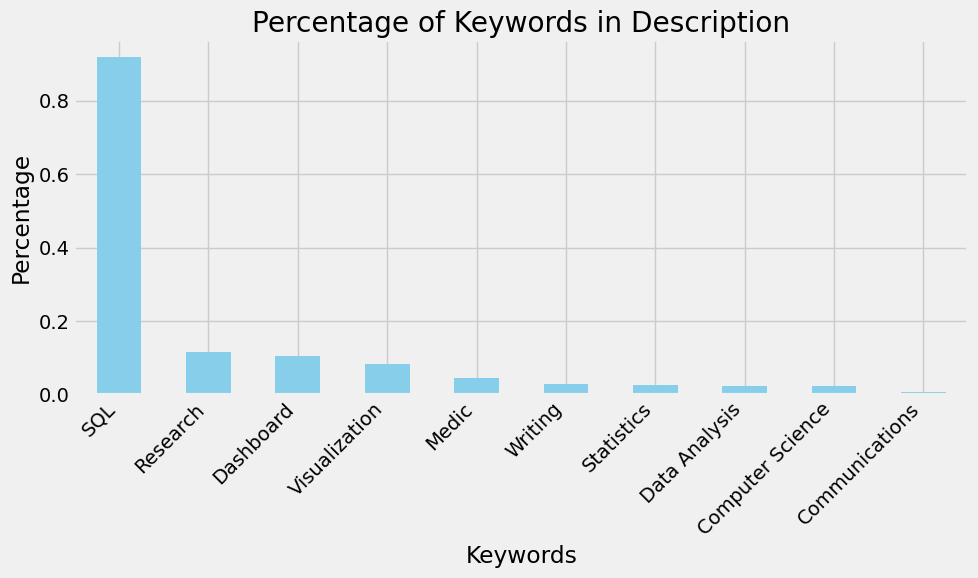

In [107]:
import matplotlib.pyplot as plt

# Annahme: keyword_percentages ist das Dictionary mit den Prozentwerten der Keywords

# Konvertieren Sie das Dictionary in ein DataFrame für die einfache Verwendung mit Matplotlib
keyword_df = pd.DataFrame.from_dict(keyword_percentages, orient='index', columns=['Percentage'])

# Sortieren Sie das DataFrame nach den Prozentwerten absteigend
keyword_df_sorted = keyword_df.sort_values(by='Percentage', ascending=False)

# Plot des Balkendiagramms
plt.figure(figsize=(10, 6))
keyword_df_sorted['Percentage'].plot(kind='bar', color='skyblue')
plt.title('Percentage of Keywords in Description')
plt.xlabel('Keywords')
plt.ylabel('Percentage')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


In [101]:
import pandas as pd

# Annahme: df ist Ihr DataFrame und keywords ist die Liste der Schlüsselwörter
keywords = ["Communications", "SQL", "Data Analysis", "Computer Science", "Statistics", "Research", "Dashboard", "Visualization", "Medic", "Writing"]

# Zählen Sie die Anzahl der Vorkommen jedes Keywords in der Spalte "Topics"
keyword_counts = {keyword: df['Topics'].str.contains(keyword).sum() for keyword in keywords}

# Berechnen Sie die Häufigkeit in Prozent
total_entries = len(df)
keyword_percentages = {keyword: (count / total_entries) * 100 for keyword, count in keyword_counts.items()}

# Zeigen Sie die Ergebnisse an
print("Keyword Counts:")
print(keyword_counts)
print("\nKeyword Percentages:")
print(keyword_percentages)

Keyword Counts:
{'Communications': 0, 'SQL': 0, 'Data Analysis': 0, 'Computer Science': 0, 'Statistics': 0, 'Research': 0, 'Dashboard': 0, 'Visualization': 0, 'Medic': 0, 'Writing': 0}

Keyword Percentages:
{'Communications': 0.0, 'SQL': 0.0, 'Data Analysis': 0.0, 'Computer Science': 0.0, 'Statistics': 0.0, 'Research': 0.0, 'Dashboard': 0.0, 'Visualization': 0.0, 'Medic': 0.0, 'Writing': 0.0}


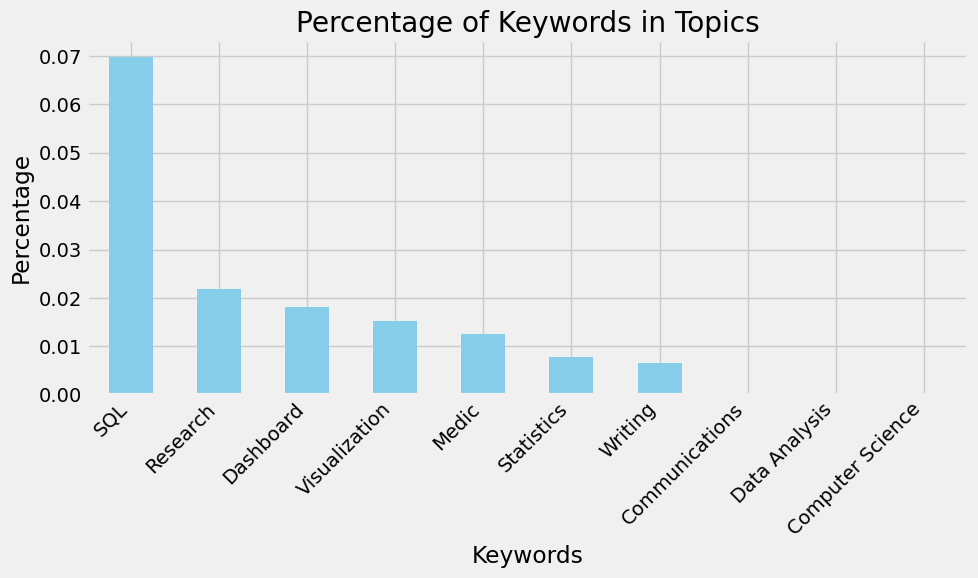

In [103]:
import matplotlib.pyplot as plt

# Annahme: keyword_percentages ist das Dictionary mit den Prozentwerten der Keywords

# Konvertieren Sie das Dictionary in ein DataFrame für die einfache Verwendung mit Matplotlib
keyword_df = pd.DataFrame.from_dict(keyword_percentages, orient='index', columns=['Percentage'])

# Sortieren Sie das DataFrame nach den Prozentwerten absteigend
keyword_df_sorted = keyword_df.sort_values(by='Percentage', ascending=False)

# Plot des Balkendiagramms
plt.figure(figsize=(10, 6))
keyword_df_sorted['Percentage'].plot(kind='bar', color='skyblue')
plt.title('Percentage of Keywords in Topics')
plt.xlabel('Keywords')
plt.ylabel('Percentage')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


In [108]:
import pandas as pd

# Annahme: df ist Ihr DataFrame und keywords ist die Liste der Schlüsselwörter
keywords = ["Communications", "SQL", "Data Analysis", "Computer Science", "Statistics", "Research", "Dashboard", "Visualization", "Medic", "Writing"]

# Zählen Sie die Anzahl der Vorkommen jedes Keywords in der Spalte "Topics"
keyword_counts = {keyword: df['Name'].str.contains(keyword).sum() for keyword in keywords}

# Berechnen Sie die Häufigkeit in Prozent
total_entries = len(df)
keyword_percentages = {keyword: (count / total_entries) * 100 for keyword, count in keyword_counts.items()}

# Zeigen Sie die Ergebnisse an
print("Keyword Counts:")
print(keyword_counts)
print("\nKeyword Percentages:")
print(keyword_percentages)

Keyword Counts:
{'Communications': 1, 'SQL': 150, 'Data Analysis': 0, 'Computer Science': 0, 'Statistics': 17, 'Research': 47, 'Dashboard': 39, 'Visualization': 33, 'Medic': 27, 'Writing': 14}

Keyword Percentages:
{'Communications': 0.000465053550916388, 'SQL': 0.06975803263745821, 'Data Analysis': 0.0, 'Computer Science': 0.0, 'Statistics': 0.007905910365578596, 'Research': 0.021857516893070236, 'Dashboard': 0.018137088485739132, 'Visualization': 0.015346767180240804, 'Medic': 0.012556445874742478, 'Writing': 0.006510749712829432}


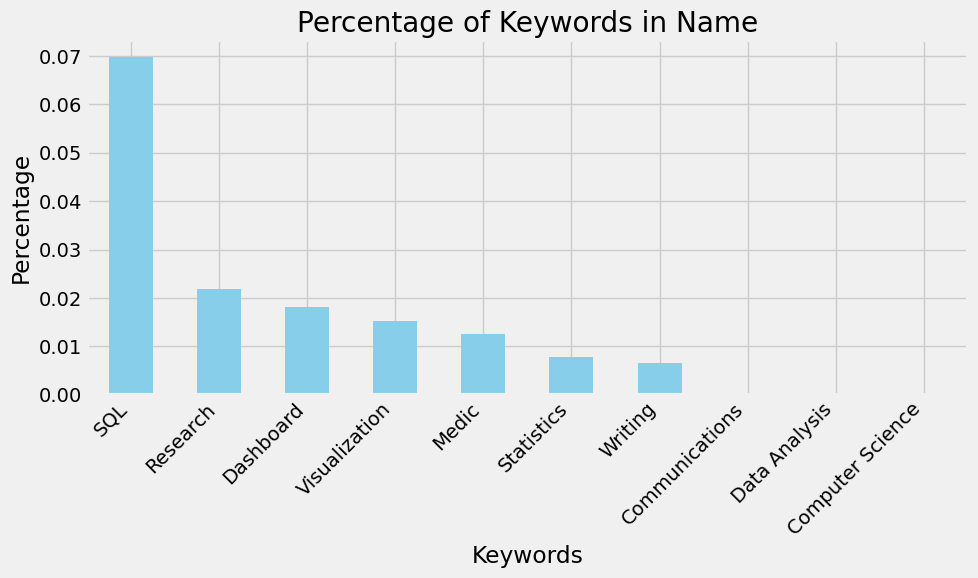

In [109]:
import matplotlib.pyplot as plt

# Annahme: keyword_percentages ist das Dictionary mit den Prozentwerten der Keywords

# Konvertieren Sie das Dictionary in ein DataFrame für die einfache Verwendung mit Matplotlib
keyword_df = pd.DataFrame.from_dict(keyword_percentages, orient='index', columns=['Percentage'])

# Sortieren Sie das DataFrame nach den Prozentwerten absteigend
keyword_df_sorted = keyword_df.sort_values(by='Percentage', ascending=False)

# Plot des Balkendiagramms
plt.figure(figsize=(10, 6))
keyword_df_sorted['Percentage'].plot(kind='bar', color='skyblue')
plt.title('Percentage of Keywords in Name')
plt.xlabel('Keywords')
plt.ylabel('Percentage')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


In [ ]:
# wenn alle softskills und hardskills verglichen sind! Ranking erstellen und gegenüberstellen mit skills ranking 
# aus 2020 und ggf. das aktuelle von AM

In [ ]:
#python fällt unter misc. interessant. bei usernames ggf. nochmal checken! 
#Kommentare noch auf Englisch!

In [ ]:
# hier müssen die spalten noch nach hardskills und softskills umbenannt werden
# count vergleichen / vorkommen / mit in github und stellen! wie unterschiedlich ist die verteilung im vergleich zu skills table? 
# noch checken! 

In [ ]:
# hier noch für hard skills und beide jeweils für die gesamte länge! plus visualisieren 
# ggf. im Zusammenhang mit Erfolg

In [ ]:
#jetzt würde ich mir gerne dazu die jeweiligen "Names" aus der Spalte "Names" anzeigen lassen

In [53]:
df.columns


Index(['Name', 'Description', 'URL', 'Created At', 'Updated At', 'Homepage',
       'Size', 'Stars', 'Forks', 'Issues', 'Watchers', 'Language', 'License',
       'Topics', 'Has Issues', 'Has Projects', 'Has Downloads', 'Has Wiki',
       'Has Pages', 'Has Discussions', 'Is Fork', 'Is Archived', 'Is Template',
       'Default Branch', 'named_entities', 'named_entities_german'],
      dtype='object')

In [54]:
# Angenommen, df ist dein DataFrame und du möchtest die 'Stars' und 'Forks' Spalten analysieren

# Beschreibung der 'Stars' Spalte
stars_description = df['Stars'].describe()

# Beschreibung der 'Forks' Spalte
forks_description = df['Forks'].describe()

# Ausgabe der Beschreibungen
print("Description of 'Stars' column:")
print(stars_description)
print("\nDescription of 'Forks' column:")
print(forks_description)


Description of 'Stars' column:
count   215,029.00
mean      1,115.09
std       3,992.37
min         167.00
25%         237.00
50%         377.00
75%         797.00
max     374,074.00
Name: Stars, dtype: float64

Description of 'Forks' column:
count   215,029.00
mean        234.21
std       1,242.97
min           0.00
25%          39.00
50%          79.00
75%         174.00
max     243,339.00
Name: Forks, dtype: float64


In [ ]:
# define success column including Stars and Forks? sth. else? 
# maybe later check correlation to "Size"

In [55]:
# Annahme: df ist dein DataFrame

# Erstellen der neuen Spalte 'Success' durch Addition von 'Forks' und 'Stars'
df['Success'] = df['Forks'] + df['Stars']

# Ausgabe der ersten paar Zeilen des DataFrames zur Überprüfung
print(df.info())


                          Name  \
0                 freeCodeCamp   
1       free-programming-books   
2                      awesome   
3                      996.ICU   
4  coding-interview-university   

                                         Description  \
0  freeCodeCamp.org's open-source codebase and cu...   
1         :books: Freely available programming books   
2  😎 Awesome lists about all kinds of interesting...   
3  Repo for counting stars and contributing. Pres...   
4  A complete computer science study plan to beco...   

                                                 URL            Created At  \
0       https://github.com/freeCodeCamp/freeCodeCamp  2014-12-24T17:49:19Z   
1  https://github.com/EbookFoundation/free-progra...  2013-10-11T06:50:37Z   
2            https://github.com/sindresorhus/awesome  2014-07-11T13:42:37Z   
3                  https://github.com/996icu/996.ICU  2019-03-26T07:31:14Z   
4  https://github.com/jwasham/coding-interview-un...  2016-06-06T02:

In [56]:
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 215029 entries, 0 to 215028
Data columns (total 27 columns):
 #   Column                 Non-Null Count   Dtype 
---  ------                 --------------   ----- 
 0   Name                   215027 non-null  object
 1   Description            206997 non-null  object
 2   URL                    215029 non-null  object
 3   Created At             215029 non-null  object
 4   Updated At             215029 non-null  object
 5   Homepage               78390 non-null   object
 6   Size                   215029 non-null  int64 
 7   Stars                  215029 non-null  int64 
 8   Forks                  215029 non-null  int64 
 9   Issues                 215029 non-null  int64 
 10  Watchers               215029 non-null  int64 
 11  Language               198953 non-null  object
 12  License                161990 non-null  object
 13  Topics                 215029 non-null  object
 14  Has Issues             215029 non-null  bool  
 15  

In [60]:
# Annahme: df ist dein DataFrame

# Sortiere den DataFrame nach der Spalte "Success" absteigend und wähle die Top 10 Einträge aus
top_10_success = df.nlargest(10, 'Success')

# Ausgabe der Top 10 Einträge
print("Top 10 Einträge nach 'Success':")
print(top_10_success[['Name', 'Topics', 'Success']])



Top 10 Einträge nach 'Success':
                           Name  \
0                  freeCodeCamp   
1        free-programming-books   
4   coding-interview-university   
2                       awesome   
3                       996.ICU   
6             developer-roadmap   
5                   public-apis   
7          system-design-primer   
12                   tensorflow   
9                         react   

                                               Topics  Success  
0   ['careers', 'certification', 'community', 'cur...   407673  
1   ['books', 'education', 'hacktoberfest', 'list'...   355587  
4   ['algorithm', 'algorithms', 'coding-interview'...   334595  
2   ['awesome', 'awesome-list', 'lists', 'resource...   296482  
3                                                  []   289398  
6   ['angular-roadmap', 'backend-roadmap', 'blockc...   286343  
5   ['api', 'apis', 'dataset', 'development', 'fre...   285869  
7   ['design', 'design-patterns', 'design-system',...   270043

In [62]:
df.columns

Index(['Name', 'Description', 'URL', 'Created At', 'Updated At', 'Homepage',
       'Size', 'Stars', 'Forks', 'Issues', 'Watchers', 'Language', 'License',
       'Topics', 'Has Issues', 'Has Projects', 'Has Downloads', 'Has Wiki',
       'Has Pages', 'Has Discussions', 'Is Fork', 'Is Archived', 'Is Template',
       'Default Branch', 'named_entities', 'named_entities_german', 'Success'],
      dtype='object')

In [63]:
# Filter the DataFrame to include only rows where either "named_entities_german" or "named_entities" is not null
filtered_df = df[(~df['named_entities_german'].isnull()) | (~df['named_entities'].isnull())]

# Create a new DataFrame with only the "Names", "Success", and "Topics" columns
selected_columns_df = filtered_df[['Name', 'Success', 'Topics']]

# Display the new DataFrame
print(selected_columns_df)


                                                  Name  Success  \
0                                         freeCodeCamp   407673   
1                               free-programming-books   355587   
2                                              awesome   296482   
3                                              996.ICU   289398   
4                          coding-interview-university   334595   
...                                                ...      ...   
215024                                     puppet-virt      240   
215025                               BounceProgressBar      203   
215026  egghead-angularjs-from-scratch-getting-started      388   
215027                                           Pcode      191   
215028                                     react-hooks      176   

                                                   Topics  
0       ['careers', 'certification', 'community', 'cur...  
1       ['books', 'education', 'hacktoberfest', 'list'...  
2       ['aweso

In [64]:
selected_columns_df.columns

Index(['Name', 'Success', 'Topics'], dtype='object')

In [66]:
# did not finally worked as the expected two entity columns are missing
# try again

import pandas as pd

# Filtern Sie den DataFrame, um nur Zeilen zu erhalten, in denen entweder "named_entities_german" oder "named_entities" nicht null sind
filtered_df = df[(~df['named_entities_german'].isnull()) | (~df['named_entities'].isnull())]

# Erstellen Sie einen neuen DataFrame mit den erforderlichen Spalten
result_df = filtered_df[['Name', 'Success', 'Topics', 'named_entities_german', 'named_entities']]

# Zeigen Sie den neuen DataFrame an
print(result_df)


                                                  Name  Success  \
0                                         freeCodeCamp   407673   
1                               free-programming-books   355587   
2                                              awesome   296482   
3                                              996.ICU   289398   
4                          coding-interview-university   334595   
...                                                ...      ...   
215024                                     puppet-virt      240   
215025                               BounceProgressBar      203   
215026  egghead-angularjs-from-scratch-getting-started      388   
215027                                           Pcode      191   
215028                                     react-hooks      176   

                                                   Topics  \
0       ['careers', 'certification', 'community', 'cur...   
1       ['books', 'education', 'hacktoberfest', 'list'...   
2       ['aw

In [67]:
result_df.columns

Index(['Name', 'Success', 'Topics', 'named_entities_german', 'named_entities'], dtype='object')

In [80]:
result_df.head()

,Name,Success,Topics,named_entities_german,named_entities
0,freeCodeCamp,407673,"['careers', 'certification', 'community', 'cur...","[(['careers, ORG), (freecodecamp, PER), (javas...",[]
1,free-programming-books,355587,"['books', 'education', 'hacktoberfest', 'list'...",[],[]
2,awesome,296482,"['awesome', 'awesome-list', 'lists', 'resource...","[(resources, PER)]",[]
3,996.ICU,289398,[],[],[]
4,coding-interview-university,334595,"['algorithm', 'algorithms', 'coding-interview'...","[(data-structures, PER)]",[]


In [ ]:
# Funktion zum Bereinigen der Einträge in der Spalte "named_entities_german"
#def clean_named_entities(entry):
    # Prüfen, ob der Eintrag ein String ist und Klammern enthält
 #   if isinstance(entry, str) and '(' in entry and ')' in entry:
        # Entfernen Sie die Klammern und führen Sie eine Strip-Operation durch, um zusätzliche Leerzeichen zu entfernen
   #     return entry.replace('(', '').replace(')', '').strip()
  #  else:
        # Wenn der Eintrag nicht korrekt formatiert ist, geben Sie ihn unverändert zurück
    #    return entry

# Wenden Sie die Funktion auf die Spalte "named_entities_german" an
#result_df_sorted['named_entities_german'] = result_df_sorted['named_entities_german'].apply(clean_named_entities)


In [ ]:
# extra spalte rank pro wording, aber woher weiß ich welches wording dann gemeint ist? 
# was muss ich rechnen

In [83]:
import pandas as pd

# Annahme: result_df ist Ihr DataFrame mit den Spalten 'Name', 'Success', 'Topics', 'named_entities_german' und 'named_entities'

# Sortieren Sie den DataFrame nach der 'Success' Spalte absteigend
result_df_sorted = result_df.sort_values(by='Success', ascending=False)

# Erstellen Sie eine neue Spalte 'Rank', die den Rang basierend auf der 'Success' Spalte angibt
result_df_sorted['Rank'] = range(1, len(result_df_sorted) + 1)

# Zeigen Sie den DataFrame mit der neuen 'Rank' Spalte an
print(result_df_sorted)


                                                    Name  Success  \
0                                           freeCodeCamp   407673   
1                                 free-programming-books   355587   
4                            coding-interview-university   334595   
2                                                awesome   296482   
3                                                996.ICU   289398   
...                                                  ...      ...   
214769                               proposal-extractors      168   
214162  the-supersonic-plugin-for-scroll-based-animation      168   
213999                                     QtVtk-Project      168   
213929                                  toucaan.research      168   
214591                                       FoodSnorlax      167   

                                                   Topics  \
0       ['careers', 'certification', 'community', 'cur...   
1       ['books', 'education', 'hacktoberfest', '

In [85]:
result_df_sorted.head()

,Name,Success,Topics,named_entities_german,named_entities,Rank
0,freeCodeCamp,407673,"['careers', 'certification', 'community', 'cur...","[(['careers, ORG), (freecodecamp, PER), (javas...",[],1
1,free-programming-books,355587,"['books', 'education', 'hacktoberfest', 'list'...",[],[],2
4,coding-interview-university,334595,"['algorithm', 'algorithms', 'coding-interview'...","[(data-structures, PER)]",[],3
2,awesome,296482,"['awesome', 'awesome-list', 'lists', 'resource...","[(resources, PER)]",[],4
3,996.ICU,289398,[],[],[],5


In [130]:
# Überprüfen Sie, ob es NaN-Werte in der Spalte "Rank" gibt
nan_count = result_df_sorted['Rank'].isna().sum()

# Ausgabe der Anzahl der NaN-Werte
print("Anzahl der NaN-Werte in der Spalte 'Rank':", nan_count)


Anzahl der NaN-Werte in der Spalte 'Rank': 0


In [122]:
import pandas as pd
import ast

# Annahme: result_df_sorted ist Ihr DataFrame

# Wandeln Sie die Strings in der Spalte "Topics" in Listen von Wörtern um
result_df_sorted['Topics'] = result_df_sorted['Topics'].apply(ast.literal_eval)

# Extrahieren Sie jedes einzelne Wort aus der Spalte "Topics" und erstellen Sie ein neues DataFrame
topics_df = result_df_sorted['Topics'].explode().reset_index(drop=True).to_frame('Topic')

# Fügen Sie die Spalte "Rank" aus dem ursprünglichen DataFrame hinzu
# Wiederholen Sie die Werte in der Spalte "Rank", um sie für jedes Wort in "Topics" zu duplizieren
topics_df['Rank'] = result_df_sorted['Rank'].repeat(result_df_sorted['Topics'].str.len()).reset_index(drop=True)

# Zeigen Sie das neue DataFrame an
print(topics_df)




                   Topic  Rank
0                careers  1.00
1          certification  1.00
2              community  1.00
3             curriculum  1.00
4                     d3  1.00
...                  ...   ...
872372               NaN   NaN
872373               css   NaN
872374  intrinsic-design   NaN
872375               web   NaN
872376               NaN   NaN

[872377 rows x 2 columns]


In [ ]:
# hier gibt es scheinbar missings? sind die wörter doppelt drin? 

In [131]:
# Überprüfen, ob es NaN-Werte in der Spalte "Topic" gibt
nan_count = topics_df['Topic'].isna().sum()

# Ausgabe der Anzahl der NaN-Werte
print("Anzahl der NaN-Werte in der Spalte 'Topic':", nan_count)


Anzahl der NaN-Werte in der Spalte 'Topic': 101072


In [132]:
# Überprüfen, ob die Spalte "Topics" NaN-Werte enthält
nan_count = result_df_sorted['Topics'].isna().sum()

# Anzeigen der Anzahl der NaN-Werte
print("Anzahl der NaN-Werte in der Spalte 'Topics':", nan_count)


Anzahl der NaN-Werte in der Spalte 'Topics': 0


Um den Fehler zu überprüfen, könnten Sie die folgenden Schritte ausführen:

Überprüfen Sie die ursprünglichen Daten in der Spalte "Topics" im DataFrame result_df_sorted, um sicherzustellen, dass sie korrekt formatiert sind.
Führen Sie erneut den Schritt zum Umwandeln der Strings in Listen von Wörtern für die Spalte "Topics" durch und überprüfen Sie, ob dabei Fehler auftreten.
Untersuchen Sie die Liste der Wörter, die aus der Spalte "Topics" extrahiert wurden, um festzustellen, ob einige Werte nicht wie erwartet behandelt wurden.
Stellen Sie sicher, dass die Schritte zur Erstellung des neuen DataFrames korrekt durchgeführt werden und dass die Zuordnung der Ranks zu den extrahierten Wörtern fehlerfrei ist.
Durch die Überprüfung dieser Schritte sollten Sie in der Lage sein, den Ursprung des Fehlers zu identifizieren und entsprechende Maßnahmen zur Behebung zu ergreifen.

In [123]:
topics_df.head()

,Topic,Rank
0,careers,1.00
1,certification,1.00
2,community,1.00
3,curriculum,1.00
4,d3,1.00


In [129]:
result_df_sorted.head()

,Name,Success,Topics,named_entities_german,named_entities,Rank,separated_Topics,Rank_Topics,count_Topics
0,freeCodeCamp,407673,"[careers, certification, community, curriculum...",[],[],1,"[['careers', 'certification', 'community', ...",0,"[1, 18, 94, 23, 75, 206, 15, 4721, 5632, 75, 1..."
1,free-programming-books,355587,"[books, education, hacktoberfest, list, resource]",[],[],2,"[['books', 'education', 'hacktoberfest', 'l...",0,"[47, 206, 4721, 291, 9]"
4,coding-interview-university,334595,"[algorithm, algorithms, coding-interview, codi...",[],[],3,"[['algorithm', 'algorithms', 'coding-intervi...",0,"[380, 128, 8, 44, 142, 330, 252, 20, 119, 5, 5..."
2,awesome,296482,"[awesome, awesome-list, lists, resources, unic...",[],[],4,"[['awesome', 'awesome-list', 'lists', 'reso...",0,"[1182, 1198, 74, 128, 12]"
3,996.ICU,289398,[],[],[],5,[[]],0,[101072]


In [91]:
import pandas as pd

# Assuming result_df_sorted is your DataFrame with columns 'Name', 'Success', 'Topics', and 'Rank'

# Create a new column "separated_Topics" by splitting the entries in the "Topics" column
result_df_sorted['separated_Topics'] = result_df_sorted['Topics'].str.split(',')

# Create an empty column "Rank_Topics" to store the ranks of individual topics
result_df_sorted['Rank_Topics'] = 0

# Iterate over each row in the DataFrame to update the ranks for each topic
for index, row in result_df_sorted.iterrows():
    topics = row['separated_Topics']
    rank = row['Rank']
    for topic in topics:
        # Remove leading and trailing whitespace
        topic = topic.strip()
        # Update the rank for this topic by adding the current rank
        result_df_sorted.at[index, 'Rank_Topics'] += rank
        # Count the number of occurrences of this topic and store it in the corresponding cell
        result_df_sorted.at[index, 'count_Topics'] = len(topics)

# Display the updated DataFrame
print(result_df_sorted.head())


                          Name  Success  \
0                 freeCodeCamp   407673   
1       free-programming-books   355587   
4  coding-interview-university   334595   
2                      awesome   296482   
3                      996.ICU   289398   

                                              Topics  \
0  ['careers', 'certification', 'community', 'cur...   
1  ['books', 'education', 'hacktoberfest', 'list'...   
4  ['algorithm', 'algorithms', 'coding-interview'...   
2  ['awesome', 'awesome-list', 'lists', 'resource...   
3                                                 []   

                               named_entities_german named_entities  Rank  \
0  [(['careers, ORG), (freecodecamp, PER), (javas...             []     1   
1                                                 []             []     2   
4                           [(data-structures, PER)]             []     3   
2                                 [(resources, PER)]             []     4   
3                  

In [92]:
result_df_sorted.head()

,Name,Success,Topics,named_entities_german,named_entities,Rank,separated_Topics,Rank_Topics,count_Topics
0,freeCodeCamp,407673,"['careers', 'certification', 'community', 'cur...","[(['careers, ORG), (freecodecamp, PER), (javas...",[],1,"[['careers', 'certification', 'community', ...",16,16.00
1,free-programming-books,355587,"['books', 'education', 'hacktoberfest', 'list'...",[],[],2,"[['books', 'education', 'hacktoberfest', 'l...",10,5.00
4,coding-interview-university,334595,"['algorithm', 'algorithms', 'coding-interview'...","[(data-structures, PER)]",[],3,"[['algorithm', 'algorithms', 'coding-intervi...",36,12.00
2,awesome,296482,"['awesome', 'awesome-list', 'lists', 'resource...","[(resources, PER)]",[],4,"[['awesome', 'awesome-list', 'lists', 'reso...",20,5.00
3,996.ICU,289398,[],[],[],5,[[]],5,1.00


In [94]:
import pandas as pd

# Assume result_df_sorted is your DataFrame with the columns 'Name', 'Success', 'Topics', 'named_entities_german', 'named_entities', and 'Rank'

# Split the 'Topics' column into individual words
result_df_sorted['separated_Topics'] = result_df_sorted['Topics'].apply(lambda x: x.split(','))

# Create a dictionary to map each word to its rank
word_rank_dict = result_df_sorted.set_index('Name')['Rank'].to_dict()

# Calculate the Rank_Topics for each row
result_df_sorted['Rank_Topics'] = result_df_sorted['separated_Topics'].apply(lambda x: sum(word_rank_dict.get(word.strip(), 0) for word in x))

# Display the DataFrame
print(result_df_sorted[['Name', 'Success', 'Topics', 'separated_Topics', 'Rank_Topics']])


                                                    Name  Success  \
0                                           freeCodeCamp   407673   
1                                 free-programming-books   355587   
4                            coding-interview-university   334595   
2                                                awesome   296482   
3                                                996.ICU   289398   
...                                                  ...      ...   
214769                               proposal-extractors      168   
214162  the-supersonic-plugin-for-scroll-based-animation      168   
213999                                     QtVtk-Project      168   
213929                                  toucaan.research      168   
214591                                       FoodSnorlax      167   

                                                   Topics  \
0       ['careers', 'certification', 'community', 'cur...   
1       ['books', 'education', 'hacktoberfest', '

In [96]:
result_df_sorted.head()

,Name,Success,Topics,named_entities_german,named_entities,Rank,separated_Topics,Rank_Topics,count_Topics
0,freeCodeCamp,407673,"['careers', 'certification', 'community', 'cur...","[(['careers, ORG), (freecodecamp, PER), (javas...",[],1,"[['careers', 'certification', 'community', ...",0,"[1, 18, 94, 23, 75, 206, 15, 4721, 5632, 75, 1..."
1,free-programming-books,355587,"['books', 'education', 'hacktoberfest', 'list'...",[],[],2,"[['books', 'education', 'hacktoberfest', 'l...",0,"[47, 206, 4721, 291, 9]"
4,coding-interview-university,334595,"['algorithm', 'algorithms', 'coding-interview'...","[(data-structures, PER)]",[],3,"[['algorithm', 'algorithms', 'coding-intervi...",0,"[380, 128, 8, 44, 142, 330, 252, 20, 119, 5, 5..."
2,awesome,296482,"['awesome', 'awesome-list', 'lists', 'resource...","[(resources, PER)]",[],4,"[['awesome', 'awesome-list', 'lists', 'reso...",0,"[1182, 1198, 74, 128, 12]"
3,996.ICU,289398,[],[],[],5,[[]],0,[101072]


In [ ]:
# Rank_Topics did not work
# count_Topics is not good readable

In [97]:
import pandas as pd

# Assume result_df_sorted is your DataFrame with the columns 'Name', 'Success', 'Topics', 'named_entities_german', 'named_entities', and 'Rank'

# Split the 'Topics' column into individual words
result_df_sorted['separated_Topics'] = result_df_sorted['Topics'].apply(lambda x: x.split(','))

# Calculate Rank_Topics for each row
result_df_sorted['Rank_Topics'] = result_df_sorted['separated_Topics'].apply(lambda x: sum(result_df_sorted[result_df_sorted['separated_Topics'].apply(lambda y: x in y)]['Rank']))

# Count the frequency of each word in 'Topics'
result_df_sorted['count_Topics'] = result_df_sorted['Topics'].apply(lambda x: [result_df_sorted['Topics'].str.count(word).sum() for word in x.split(',')])

# Display the DataFrame
print(result_df_sorted[['Name', 'Success', 'Topics', 'separated_Topics', 'Rank_Topics', 'count_Topics']])


KeyboardInterrupt: 

In [90]:
rank_by_named_entities_german_sorted.head()

,named_entities_german,Rank
3019,"(['explore, ORG)","215,010.00"
4616,"(['word-counter, ORG)","214,998.00"
3619,"(['insomnia', ORG)","214,970.00"
15121,"(sonatype-nexus, MISC)","214,947.00"
3669,"(['iterm2', 'iterm2-borderless, ORG)","214,946.00"


In [ ]:
# rank needs to be calculated by seperated words

In [ ]:
# check success correlating to Topics? How? Via entities? Or via skills from KG and AM? lets check 
# first try with list of yesterday 